In [1]:
import cv2
import gcsfs
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras import Sequential
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.layers import Input,Conv2D,Dropout,Reshape

In [2]:
FS = gcsfs.GCSFileSystem()

try:
    gpus = tf.config.list_physical_devices("GPU")
    tf.config.set_visible_devices(gpus[2], "GPU")
except:
    print("Gpus not found")

def extend_list(lol):
    if len(lol) > 50:
        lol = lol[:50]
    else:
        lol.extend((50-len(lol))*[[0,0]])
    lol = np.array([(np.array(i).flatten())/(256) for i in lol]).flatten()
    return lol

Gpus not found


In [24]:
df=pd.read_csv("/Users/srinathramalingam/Desktop/codebase/TEST/dataset.csv")
df["coords_vals"]=df["coords_vals"].apply(eval)
# df["coords_vals"]=df["coords_vals"].apply(extend_list)


images = []
for i in range(4665):
    img = cv2.imread(f"/Users/srinathramalingam/Desktop/codebase/TEST/test_parcel/train/{i}.png")
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    images.append([img])
    
df["images"] = images

In [25]:
df.to_csv("dataset.csv", index=None)

In [26]:
df2 = pd.read_csv("dataset.csv")

In [28]:
df2["images"][0]

'[array([[0, 0, 0, ..., 0, 0, 0],\n       [0, 0, 0, ..., 0, 0, 0],\n       [0, 0, 0, ..., 0, 0, 0],\n       ...,\n       [0, 0, 0, ..., 0, 0, 0],\n       [0, 0, 0, ..., 0, 0, 0],\n       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)]'

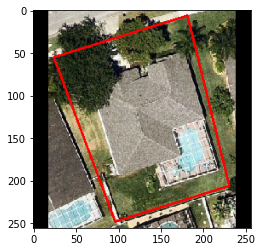

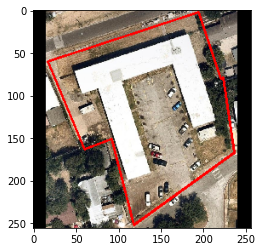

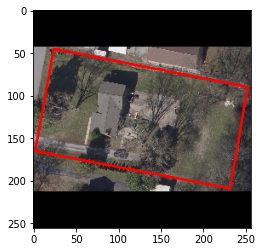

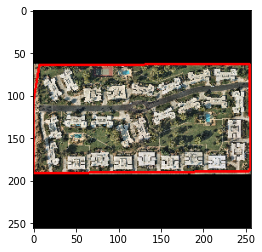

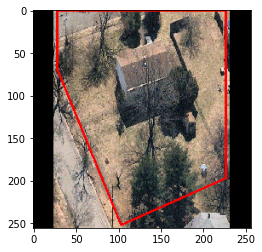

...

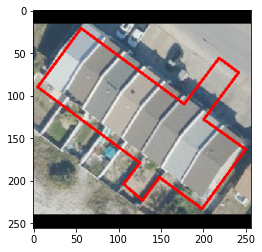

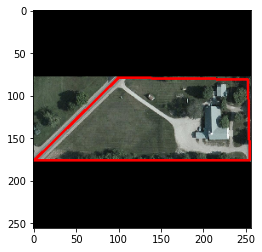

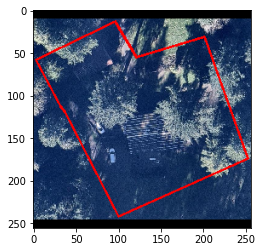

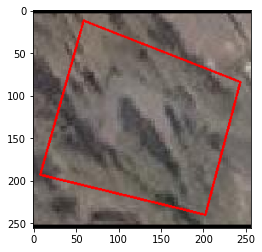

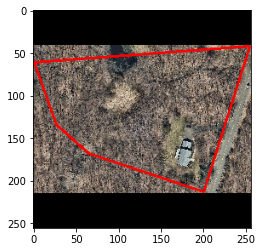

In [5]:
for i,img in enumerate(images[-200:]):
    rounded = np.rint(df["coords_vals"][i+len(images)-200]).astype(np.int32)
    img = cv2.polylines(img, [rounded], True, (255,0,0), 2)
    plt.imshow(img)
    plt.show()

In [14]:
df1 = df[df["after_cleanup_len"]==4]

In [15]:
images1 = df1["images"]

,gtu_ids,before_cleanup_len,after_cleanup_len,before_cleanup_coords,after_cleanup_coords,transformed_coords,coords_vals,images
3,719057,5,4,[[ 64 18]\n [ 3 168]\n [192 236]\n [251 76]...,"[array([64, 18], dtype=int32), array([ 3, 168...","[array([64, 18], dtype=int32), array([ 3, 168...","[[64, 18], [3, 168], [192, 236], [251, 76]]","[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ..."
4,1033741,7,4,[[ 221 9]\n [1406 1067]\n [ 218 250]\n [ ...,"[array([221, 9], dtype=int32), array([218, 2...","[array([221, 9], dtype=int32), array([218, 2...","[[221, 9], [218, 250], [33, 248], [35, 5]]","[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ..."
8,170134,5,4,[[ 56 253]\n [ 57 2]\n [ 199 5]\n [ 1...,"[array([ 56, 253], dtype=int32), array([57, 2...","[array([ 56, 253], dtype=int32), array([57, 2...","[[56, 253], [57, 2], [199, 5], [198, 251]]","[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ..."
11,429805,5,4,[[252 178]\n [ 2 177]\n [ 3 75]\n [252 76]...,"[array([252, 178], dtype=int32), array([ 2, 1...","[array([252, 178], dtype=int32), array([ 2, 1...","[[252, 178], [2, 177], [3, 75], [252, 76]]","[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ..."
13,187969,5,4,[[237 181]\n [146 5]\n [ 17 74]\n [107 250]...,"[array([237, 181], dtype=int32), array([146, ...","[array([237, 181], dtype=int32), array([146, ...","[[237, 181], [146, 5], [17, 74], [107, 250]]","[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ..."


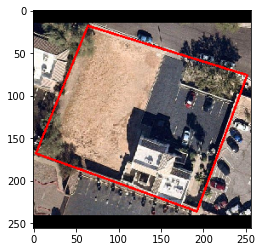

In [17]:
for img in df["images"]:
    